### Load  Uber GPS data 

Like the NYC Taxi dataset, the Uber dataset contains GPS coordinates from New York City streets.  Unlike NYC taxi, these coordinates are not limited to pickup and dropoff locations, but also include intermediate locations with associated timestamps, conceivably making it possible to reconstruct trajectory information.

In [1]:
import pandas as pd
path = 'data/uberdata/uber-raw-data-{0}14.csv'
months = ['apr', 'may', 'jun', 'jul', 'aug', 'sep']
%time df = pd.concat((pd.read_csv(path.format(m)) for m in months), ignore_index=True)
df.tail()

CPU times: user 3.16 s, sys: 370 ms, total: 3.53 s
Wall time: 3.55 s


,Date/Time,Lat,Lon,Base
4534322,9/30/2014 22:57:00,40.7668,-73.9845,B02764
4534323,9/30/2014 22:57:00,40.6911,-74.1773,B02764
4534324,9/30/2014 22:58:00,40.8519,-73.9319,B02764
4534325,9/30/2014 22:58:00,40.7081,-74.0066,B02764
4534326,9/30/2014 22:58:00,40.7140,-73.9496,B02764


For April-September 2014, there are about 4.5 million longitude, latitude GPS coordiates.  To make it easier to overlay those with tiles from map providers, we will first convert these coordinates into meters west and north of Greenwich (Web Mercator format).

In [2]:
import numpy as np
def lonlat_to_meters(df, lon_name, lat_name):
    lat = df[lat_name]
    lon = df[lon_name]
    origin_shift = 2 * np.pi * 6378137 / 2.0
    mx = lon * origin_shift / 180.0
    my = np.log(np.tan((90 + lat) * np.pi / 360.0)) / (np.pi / 180.0)
    my = my * origin_shift / 180.0
    df.loc[:, lon_name] = mx
    df.loc[:, lat_name] = my

lonlat_to_meters(df, 'Lon', 'Lat')
df.rename(columns={'Lon':'x', 'Lat':'y'}, inplace=True)

df.tail()

,Date/Time,y,x,Base
4534322,9/30/2014 22:57:00,4.978005e+06,-8.235917e+06,B02764
4534323,9/30/2014 22:57:00,4.966885e+06,-8.257379e+06,B02764
4534324,9/30/2014 22:58:00,4.990521e+06,-8.230061e+06,B02764
4534325,9/30/2014 22:58:00,4.969381e+06,-8.238377e+06,B02764
4534326,9/30/2014 22:58:00,4.970248e+06,-8.232032e+06,B02764




### Define a simple plot

In [3]:
from bokeh.plotting import figure, output_notebook, show

output_notebook()

x_range=(-8250000,-8210000)
y_range=(4965000,4990000)

def base_plot(tools='pan,wheel_zoom,reset',plot_width=900, plot_height=600, **plot_args):
    p = figure(tools=tools, plot_width=plot_width, plot_height=plot_height,
               x_range=x_range, y_range=y_range, 
               outline_line_color=None,
            min_border=0, min_border_left=0, min_border_right=0,
            min_border_top=0, min_border_bottom=0, **plot_args)
    
    p.axis.visible = False
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    return p
    
options = dict(line_color=None, fill_color='blue', size=5)

from IPython.core.display import HTML, display
display(HTML("<style>.container { width:90% !important; }</style>"))

Loading BokehJS ...

In [4]:
import datashader as ds
from datashader import transfer_functions as tf

In [5]:
%%time
cvs = ds.Canvas(plot_width=800, plot_height=500, x_range=x_range, y_range=y_range)
agg = cvs.points(df, 'x', 'y')
img = tf.interpolate(agg)

CPU times: user 343 ms, sys: 20 ms, total: 363 ms
Wall time: 364 ms


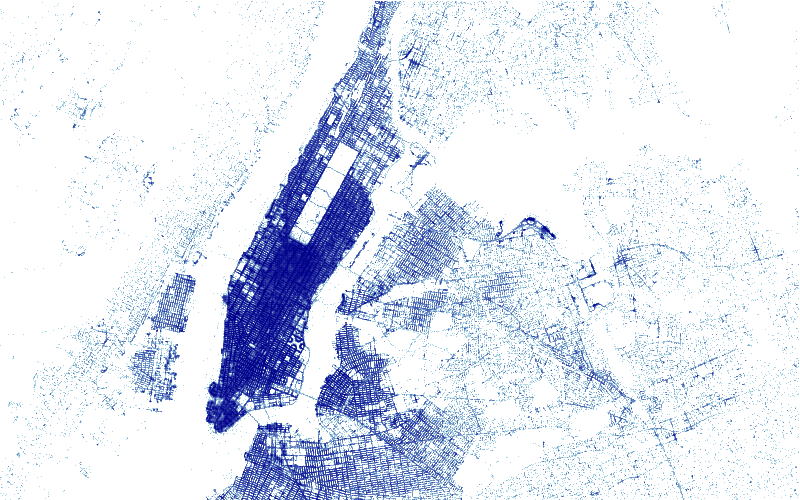

In [6]:
img

In [7]:
import datashader as ds
from datashader.bokeh_ext import InteractiveImage
from datashader.colors import Hot

def create_image(x_range, y_range, w, h):
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cvs.points(df, 'x', 'y')
    img = tf.interpolate(agg, cmap=Hot)
    return tf.dynspread(img, threshold=0.5, max_px=4)

p = base_plot(background_fill_color="black",responsive=True, plot_width=int(900*1.5), plot_height=int(600*1.5))
InteractiveImage(p, create_image)

Each datapoint has an associated Base, of which there are only a few in the dataset, so we'll convert that column into categorical information:

In [8]:
df["Base"]=df["Base"].astype("category")
list(df.Base.unique())

['B02512', 'B02598', 'B02617', 'B02682', 'B02764']

If we color each datapoint with its base, there's no particular color associated with a particular geographic region, suggesting that bases each cover the same geographic range:

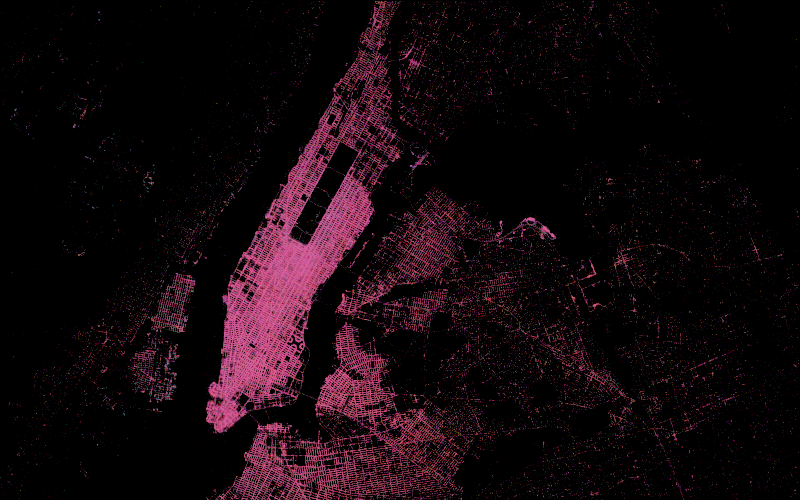

In [9]:
color_key = ['aqua', 'lightblue', 'red', 'fuchsia', 'yellow']

cvs = ds.Canvas(plot_width=800, plot_height=500, x_range=x_range, y_range=y_range)
agg = cvs.points(df, 'x', 'y', ds.count_cat('Base'))
tf.set_background(tf.colorize(agg, color_key), "black")

Now let's see if we can get any trajectory information by connecting up subsequent points for a specific base:

In [10]:
import numpy as np
from functools import partial
from bokeh.tile_providers import STAMEN_TERRAIN

p = base_plot()

df_B02512 = df[df.Base == 'B02512']

def create_image2512(x_range, y_range, w, h):
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cvs.line(df_B02512, 'x', 'y', agg=ds.any())
    return tf.interpolate(agg)
    
InteractiveImage(p, create_image2512)

Looks like a mess!  No structure is apparent when zooming in, either.  Let's look at a small subset to see what's going on:

In [11]:
df_B02512 = df[df.Base == 'B02512'].tail(50)
df_B02512

,Date/Time,y,x,Base
3540511,9/30/2014 21:36:00,4.978138e+06,-8.235828e+06,B02512
3540512,9/30/2014 21:37:00,4.959870e+06,-8.214221e+06,B02512
3540513,9/30/2014 21:37:00,4.971526e+06,-8.237442e+06,B02512
3540514,9/30/2014 21:39:00,4.974185e+06,-8.238143e+06,B02512
3540515,9/30/2014 21:39:00,4.972187e+06,-8.235305e+06,B02512
3540516,9/30/2014 21:39:00,4.976007e+06,-8.235305e+06,B02512
3540517,9/30/2014 21:39:00,4.976888e+06,-8.233312e+06,B02512
3540518,9/30/2014 21:40:00,4.970351e+06,-8.236674e+06,B02512
3540519,9/30/2014 21:42:00,4.971173e+06,-8.238054e+06,B02512
3540520,9/30/2014 21:43:00,4.977947e+06,-8.236729e+06,B02512


In [12]:
p = base_plot()
p.add_tile(STAMEN_TERRAIN)
InteractiveImage(p, create_image2512)

Even with just 50 points, which are clearly organized chronologically, there doesn't seem to be any clear trajectory structure.  Perhaps because data from multiple vehicles is combined into the same base?  That does seem to be the case, since there are multiple entries at different GPS coordinates for the same minute in the above listing.